# collection of recipes from class notes

## 0. Common Setup

In [1]:
%matplotlib inline

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pickle
import functools
from glob import glob

from skimage.measure import LineModel, ransac
from sklearn.cluster import KMeans

In [3]:
test_imgs = [cv2.cvtColor(cv2.imread(f), cv2.COLOR_BGR2RGB) 
                   for f in glob("test_images/*.jpg")]

### Conventions
Except explictly stated, all image inputs to the methods in this note will be RGB

### genearal pipeline function

In [4]:
def make_pipeline(steps):
    """Create a pipeline composed of each step
    """
    def compose2(f, g):
        return lambda x: g(f(x))
    return functools.reduce(compose2, steps)
def AND(f, g):
    """Return the AND operation result of two steps
    """
    def _and(x):
        return f(x) & g(x)
    return _and
def OR(f, g):
    """Return the OR operation result of two steps
    """
    def _or(x):
        return f(x) | g(x)
    return _or

In [5]:
## test make a pipe
fs = [lambda x, i=i: "%s -> f%d" % (x, i) for i in range(10)]
p = make_pipeline(fs)
p("s")

's -> f0 -> f1 -> f2 -> f3 -> f4 -> f5 -> f6 -> f7 -> f8 -> f9'

## 1. Camera Calibration

In [6]:
class CameraCalibrator(object):
    """Calibrate camera by estimating the distortion
    matrix and coefficients.
    """
    def __init__(self):
        """Class members:
        `self.M`: distortion matrix
        `self.d`: distortion coefficients
        """
        self.M = None
        self.d = None
    def fit(self, chessboard_images, nx=9, ny=6, img_size=None):
        """Estimate distortion matrix and coefficients
        by training on a set of chessboard images.
        `chessboard_images`: list of RGB images, assuming they
          are from the same chessboard and same camera, and of
          roughly the same size.
        `nx`,`ny`: number of corners in x and y directions
        """
        if img_size == None:
            h, w = chessboard_images[0].shape[:2]
            img_size = (w, h)
        objp = np.array([(x, y, 0) for y in range(ny) for x in range(nx)], dtype=np.float32)
        objpts, imgpts = [], []
        for img in chessboard_images:
            # convert to gray and find corner points
            gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
            ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
            if ret:
                objpts.append(objp)
                imgpts.append(corners)
                cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
            else:
                # ignore images that cannot be used
                print("Cannot find corner points in image")
        ret, self.M, self.d, rvecs, tvecs = cv2.calibrateCamera(objpts, imgpts, img_size, None, None)
        return self
    def save(self, model_file):
        model = {"M": self.M, "d": self.d}
        pickle.dump(model, open(model_file, "wb"))
        print("calibration model saved at %s" % model_file)
        return self
    def restore(self, model_file):
        model = pickle.load(open(model_file, "rb"))
        self.M = model["M"]
        self.d = model["d"]
        print("calibration model restored from %s" % model_file)
        return self
    def undistort(self, img):
        """img: original RGB img to be undistorted
        Return undistorted image.
        """
        undist = cv2.undistort(img, self.M, self.d, None, self.M)
        return undist

### test camera calibration

Cannot find corner points in image
Cannot find corner points in image
calibration model saved at tmp/camera_calibrator.p
calibration model restored from tmp/camera_calibrator.p


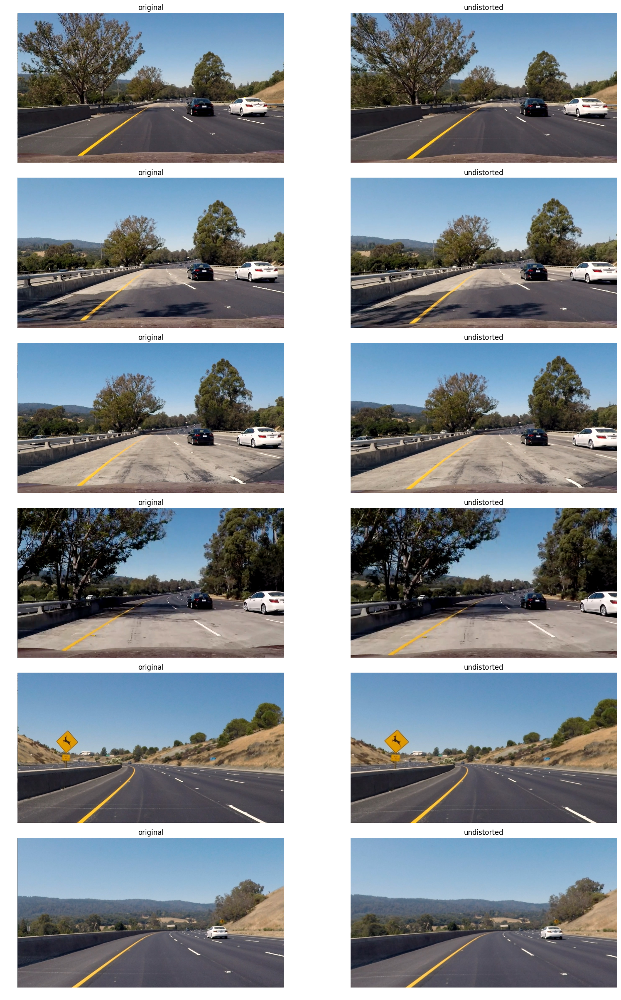

In [7]:
from glob import glob
chessboard_imgs = [cv2.cvtColor(cv2.imread(f), cv2.COLOR_BGR2RGB) 
                   for f in glob("camera_cal/*.jpg")]
cc = CameraCalibrator()
cc.fit(chessboard_imgs)
cc.save("tmp/camera_calibrator.p")
cc.restore("tmp/camera_calibrator.p")


fig, axes = plt.subplots(6, 2, figsize = (8*2, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for ax, test_img in zip(axes, test_imgs):
    ax[0].imshow(test_img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    undist = cc.undistort(test_img)
    ax[1].imshow(undist)
    ax[1].set_title("undistorted")
    ax[1].set_axis_off()

## 2. Line Detection

In [8]:
class LineDetector(object):
    """Detect lines (e.g. lane boundaries) in images using a combination 
    of different methods. It supports different line detection 
    algorithms and their combinations. For now the user needs 
    to pre-configure the methods beforehand, it may support 
    automated algorithm selection based on images in the future.
    
    There are three main steps in configuring a line detector:
        - convert color images to gray, e.g, by RGB->gray or HLS->S
        - line detection, e.g., canny, sobel_x, sobel_y, sobel_magnitude, sobel_dir
        - filtering, e.g., by threshold of pixel, line oritentation, etc.
    A pipeline can be built by setting different choices at each setp.
    A combination can be done by using AND/OR operations on the resulted line(binary) images.
    The combination also has a smoothing effect like Gaussian filtering. Using a larger
    `ksize` has the same effect.
    """
    def __init__(self):
        pass
    def gray_converter(self, gray_type):
        """Create gray_image_converter for line detecion pipeline.
        `gray_type`: {"gray", "saturation", "hue"}.
        Returns a gray image converter function with RGB image input
            and a gray image output 
        """
        gray_type = gray_type.lower()
        def f(img):
            if gray_type == "gray":
                return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
            elif gray_type == "saturation":
                return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:, :, 2]
            elif gray_type == "hue":
                return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:, :, 0]
            elif gray_type == "lightness":
                return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:, :, 1]
            else:
                raise ValueError("Unknown gray_type %s" % gray_type)
        return f
    def sobel_detector(self, sobel_type, ksize=3):
        """Create sobel based line dector for line detection pipeline.
        `sobel_type`: {"x", "y", "magnitude", "direction"}.
        `ksize`: kernel size for Sobel filter, default to 3
        Returns a function with gray image input and a Sobel image output, 
            the pixels of Sobel image is within [-$\pi$/2, $\pi$/2] for 'direction'
            and [0, 255] for other sobel_types
        """
        sobel_type = sobel_type.lower()
        def f(gray):
            sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=ksize)
            sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=ksize)
            if sobel_type == "x":
                sobel = np.absolute(sobelx)
            elif sobel_type == "y":
                sobel = np.absolute(sobely)
            elif sobel_type == "magnitude":
                sobel = np.sqrt(sobelx*sobelx + sobely*sobely)
            elif sobel_type == "direction":
                sobel = np.arctan(sobely / (sobelx + 1e-6))
            else:
                raise ValueError("Unknown sobel_type %s" % sobel_type)
            # normalize sobel as a normal gray image, so it can be visualized
            if sobel_type in ["x", "y", "magnitude"]:
                sobel = (sobel * 255. / sobel.max()).astype(np.uint8)
            return sobel
        return f
    def threshold_filter(self, lower, upper):
        """Create binary filter for line detection pipeline.
        `lower`, `upper` are bounds for pixel value (distributed between 0, 255).
        Returns a function that returns a binary image, where pixels in [lower, upper]
        are 1 and the rest are 0.
        """
        def f(gray):
            binary = (gray >= lower) & (gray <= upper)
            return binary
        return f

### test line detector

In [9]:
ld = LineDetector()

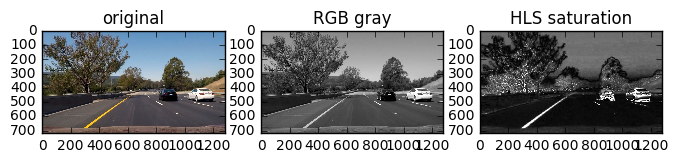

In [10]:
## test gray converter
rgb_gray_converter = ld.gray_converter("gray")
hls_gray_converter = ld.gray_converter("saturation")
test_img = test_imgs[0]
rgb_gray = rgb_gray_converter(test_img)
hls_gray = hls_gray_converter(test_img)
fig, axes = plt.subplots(1, 3, figsize=(8*1, 3*4))
axes[0].imshow(test_img)
axes[0].set_title("original")
axes[1].imshow(rgb_gray, cmap=plt.cm.gray)
axes[1].set_title("RGB gray")
axes[2].imshow(hls_gray, cmap=plt.cm.gray)
axes[2].set_title("HLS saturation")

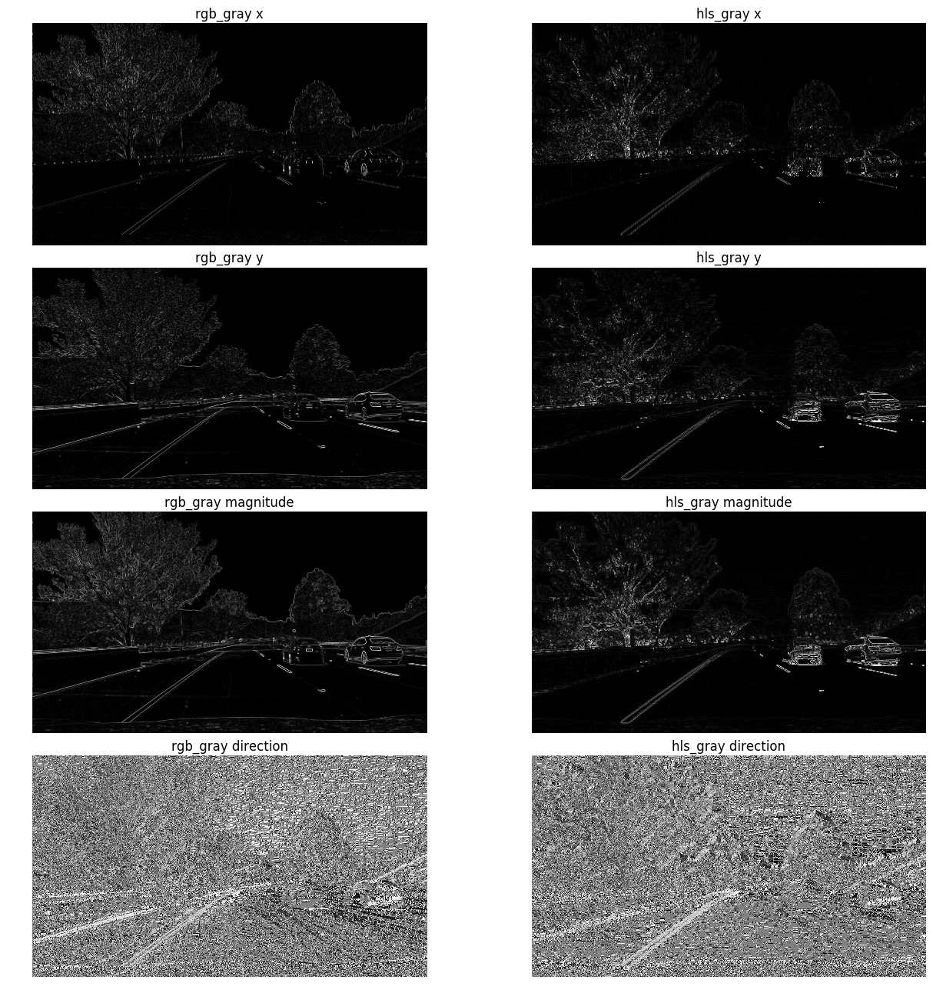

In [11]:
## test sobel filter
fig, axes = plt.subplots(4, 2, figsize=(2*8, 4 * 4))
fig.subplots_adjust(wspace=0.1, hspace=0.1)
gray_imgs = [("rgb_gray", rgb_gray), ("hls_gray", hls_gray)]
sobels = [(s, ld.sobel_detector(s)) for s in ["x", "y", "magnitude", "direction"]]
for c, (gray_type, gray_img) in enumerate(gray_imgs):
    for r, (sobel_type, sobel_fn) in enumerate(sobels):
        sobel = sobel_fn(gray_img)
        axes[r,c].imshow(sobel, cmap=plt.cm.gray)
        axes[r,c].set_title("%s %s" % (gray_type, sobel_type))
        axes[r,c].set_axis_off()

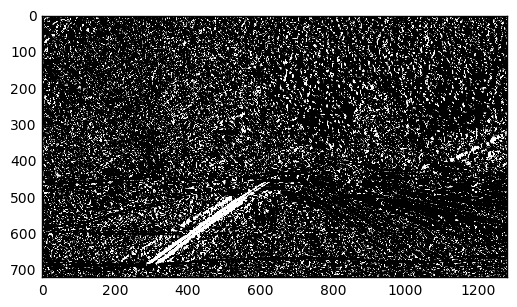

In [12]:
## test make a line detector by piping different steps

directional_line_detector = make_pipeline([
    ld.gray_converter("gray")
    , ld.sobel_detector("direction", ksize=15)
    , ld.threshold_filter(0.7, 1.2)
#     , ld.threshold_filter(-1.2, 0.7)
])

directional_line_img = directional_line_detector(test_imgs[0])
plt.imshow(directional_line_img, cmap=plt.cm.gray)

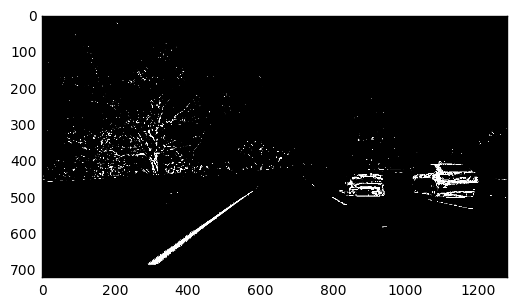

In [13]:

color_line_detector = make_pipeline([
    ld.gray_converter("saturation")
    , ld.threshold_filter(175, 255)
])

color_line_img = color_line_detector(test_imgs[0])
plt.imshow(color_line_img, cmap=plt.cm.gray)

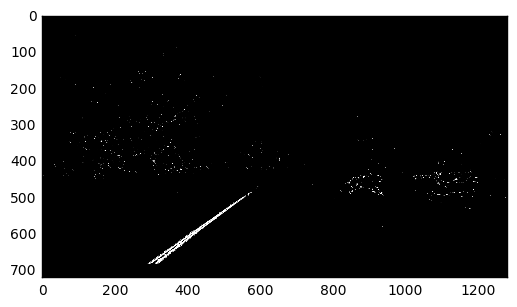

In [14]:
# combination
combined_line = directional_line_img&color_line_img
plt.imshow(combined_line, cmap=plt.cm.gray)

### observations
two steps
- make all lines that should be detected visible
- remove noise

some tricks
- color_detector is going to help a lot with reducing noise, e.g., trees that have dark colors

In [15]:
# it seems to be a good detector by combining lightness, 
# saturation channel and directional filtering


ld = LineDetector()

ksize = 11
gradx_detector1 = make_pipeline([
        ld.gray_converter("lightness")
        , ld.sobel_detector("x", ksize=ksize)
        , ld.threshold_filter(25, 125)
])
left_dir_detector1 = make_pipeline([
        ld.gray_converter("lightness")
        , ld.sobel_detector("direction", ksize=ksize)
        , ld.threshold_filter(0.3, 1.5)
#         , ld.threshold_filter(0.7, 1.2)
        
])
right_dir_detector1 = make_pipeline([
        ld.gray_converter("lightness")
        , ld.sobel_detector("direction", ksize=ksize)
        , ld.threshold_filter(-1.5, -0.3)    
])
line_detector1 = AND( gradx_detector1, OR(left_dir_detector1, right_dir_detector1))

gradx_detector2 = make_pipeline([
        ld.gray_converter("saturation")
        , ld.sobel_detector("x", ksize=ksize)
        , ld.threshold_filter(25, 125)
])
left_dir_detector2 = make_pipeline([
        ld.gray_converter("saturation")
        , ld.sobel_detector("direction", ksize=ksize)
        , ld.threshold_filter(0.3, 1.5)
#         , ld.threshold_filter(0.7, 1.2)
])
right_dir_detector2 = make_pipeline([
        ld.gray_converter("saturation")
        , ld.sobel_detector("direction", ksize=ksize)
        , ld.threshold_filter(-1.5, -0.3)
        
])
line_detector2 = AND( gradx_detector2, OR(left_dir_detector2, right_dir_detector2))

line_detector = OR(line_detector1, line_detector2)

# H, W = test_imgs[0].shape[:2]
# roi = np.array([[(0,H), (W/2-40, H/2+40), (W/2+40, H/2+40),(W,H)]], dtype=np.int32)
# trapezoidal_roi_cropper = ld.roi_cropper(roi)
# line_detector = make_pipeline([line_detector, trapezoidal_roi_cropper])

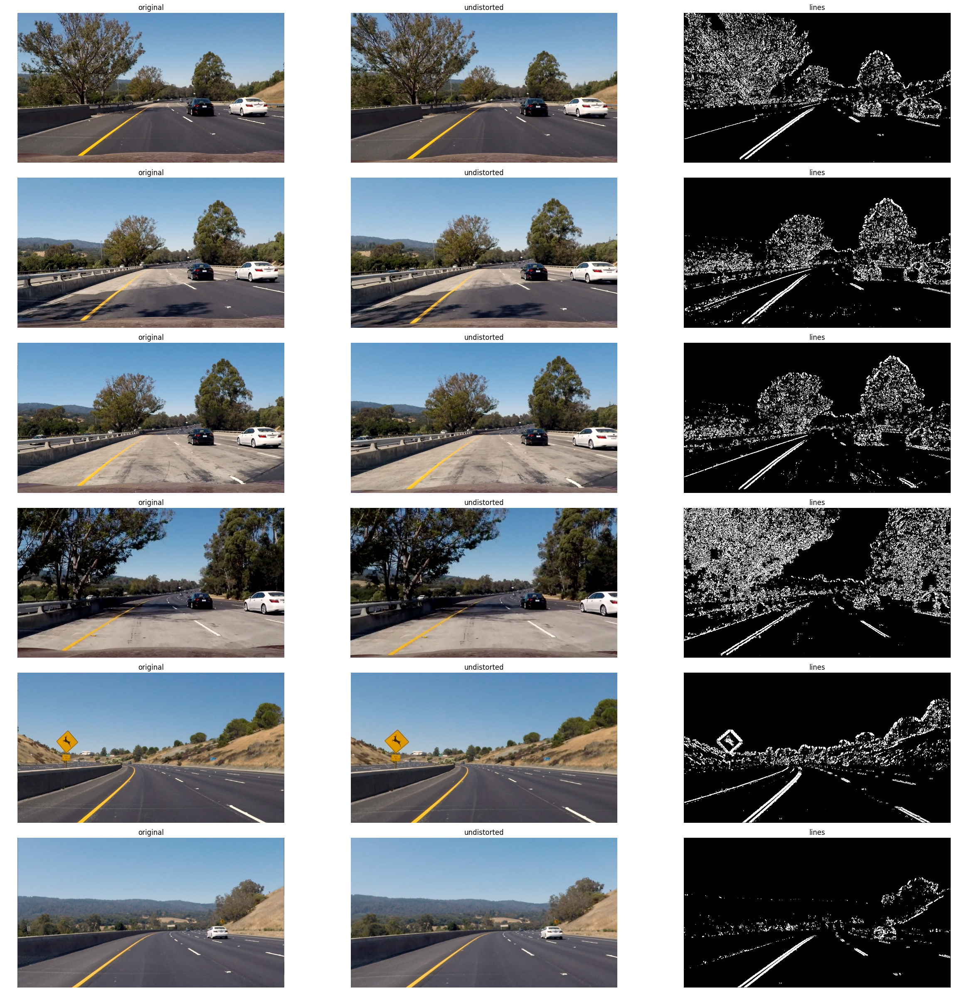

In [16]:
fig, axes = plt.subplots(6, 3, figsize = (8*3, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for ax, test_img in zip(axes, test_imgs):
    ax[0].imshow(test_img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    
    test_img = cc.undistort(test_img)
    ax[1].imshow(test_img)
    ax[1].set_title("undistorted")
    ax[1].set_axis_off()
    
    lines = line_detector(test_img)
    ax[2].imshow(lines, cmap=plt.cm.gray)
    ax[2].set_title("lines")
    ax[2].set_axis_off()

## 3. Perspective Transform
- based on the class, the perspective matrix can be estimated from a single image and applied to many other, assuming that the road is flat and the camera perspective hasn't changed (really??).
- and it can be tested on new images to see whether the transformed lines are "almost parallel" in bird-eye's view.
- the image used to estimate the perspective transform matrix should be clear and lanes are ideally straight - so it can be easily tested.

### 3.1 trying to get the lines

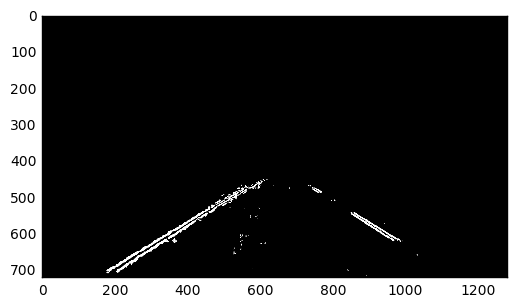

In [238]:
test_img = test_imgs[3]
test_img = cc.undistort(test_img)

H, W = test_img.shape[:2]
roi = np.array([[(40,H), (W/2-40, H/2+80), (W/2+40, H/2+80),(W-40,H)]], dtype=np.int32)

from functools import partial
def crop_roi(bin_img, roi, roi_value=1):
    """Crop the roi region of an image, by masking out the other regions.
    - `bin_img`: a binary image, e.g. an image with detected lines.
    - `roi`: region of interest and other areas will be masked out
    """
    mask = np.zeros_like(bin_img, dtype=np.int32)
    cv2.fillPoly(mask, roi, roi_value)
    masked_img = (bin_img & mask)
    return masked_img

undistort_line = make_pipeline([line_detector, partial(crop_roi, roi=roi)])
line_img = undistort_line(test_img)
plt.imshow(line_img, cmap = plt.cm.gray)

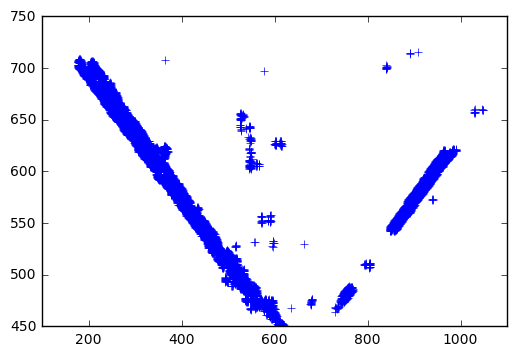

In [239]:
ys, xs = np.where(line_img > 0)
# ys = H - ys
plt.plot(xs, ys, "b+")

In [240]:
from sklearn.cluster import KMeans
cluster2 = KMeans(2)
cluster2.fit(np.c_[xs, ys])

KMeans(copy_x=True, init='k-means++', max_iter=300, n_clusters=2, n_init=10,
    n_jobs=1, precompute_distances='auto', random_state=None, tol=0.0001,
    verbose=0)

/root/anaconda3/lib/python3.5/site-packages/skimage/measure/fit.py:57: skimage_deprecation: `LineModel` is deprecated, use `LineModelND` instead.
  warn(skimage_deprecation('`LineModel` is deprecated, '


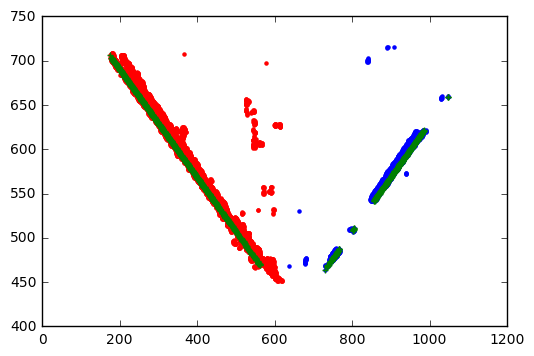

In [241]:
from skimage.measure import LineModel, ransac

linear_models = []
colors = ["r", "b"]
for c, col in enumerate(colors):
    i = (cluster2.labels_ == c)
    
    robust_model, inliers = ransac(np.c_[xs[i], ys[i]], LineModel, 
                                min_samples=2, residual_threshold=1., max_trials=500)
    linear_models.append(robust_model)
    plt.scatter(xs[i], ys[i], color=col, marker=".")
    plt.scatter(xs[i][inliers], ys[i][inliers], color="green", marker="+")

In [242]:
m = linear_models[0]
print(m.params)
print(m.predict_x(H/2))

(693.38177447816463, 1.0222259069826354)
740.609782411


720 460


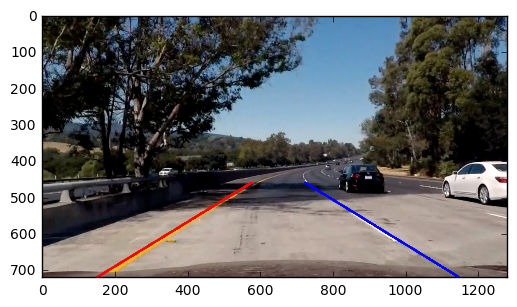

In [243]:
plot_img = test_img.copy()
#plt.imshow(plot_img)
middle_h = H//2+100 #H*3//4
line0 = [(int(linear_models[0].predict_x(H)), H), (int(linear_models[0].predict_x(middle_h)), middle_h)]
line1 = [(int(linear_models[1].predict_x(H)), H), (int(linear_models[1].predict_x(middle_h)), middle_h)]
cv2.line(plot_img, line0[0], line0[1], [255, 0, 0], thickness=5)
cv2.line(plot_img, line1[0], line1[1], [0, 0, 255], thickness=5)
#cv2.fillPoly(plot_img, np.array([np.array(line0+line1[::-1])]), [0, 255, 0])
plt.imshow(plot_img)
print(H, middle_h)

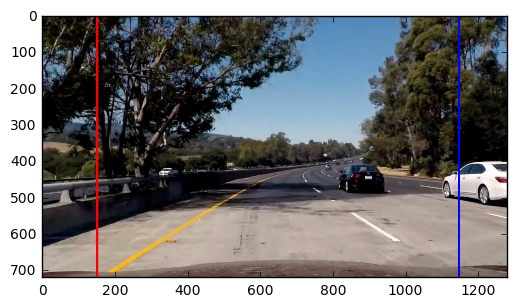

In [244]:
# find source and destination points
middle_h = H/2+100 #H*3/4
line0 = [(linear_models[0].predict_x(H), H), (linear_models[0].predict_x(middle_h), middle_h)]
line1 = [(linear_models[1].predict_x(H), H), (linear_models[1].predict_x(middle_h), middle_h)]
src_pts = np.array(line0 + line1)
bottom_x1, bottom_x2 = line0[0][0], line1[0][0]
# bottom_x1, bottom_x2 = line0[0][0], line0[0][0]+700 # fix the width to be 700, we know it is 3.7 meters
# bottom_x1, bottom_x2 = 600-350, 600+350
v = np.array(line0[1]) - np.array(line0[0])
L = H#int(np.sqrt(np.sum( v*v )))
dst_pts = [(bottom_x1, H), (bottom_x1, H-L),
                   (bottom_x2, H), (bottom_x2, H-L)]
# b = 100
# dst_pts = [(b, H-b), (b, b),
#                    (W-b, H-b), (W-b, b)]

plot_img2 = test_img.copy()
cv2.line(plot_img2, tuple(map(int,dst_pts[0])), tuple(map(int,dst_pts[1])), [255, 0, 0], thickness=5)
cv2.line(plot_img2, tuple(map(int,dst_pts[2])), tuple(map(int,dst_pts[3])), [0, 0, 255], thickness=5)
plt.imshow(plot_img2)

dst_pts = np.array(dst_pts)

In [245]:
print (bottom_x2-bottom_x1)

994.063378261


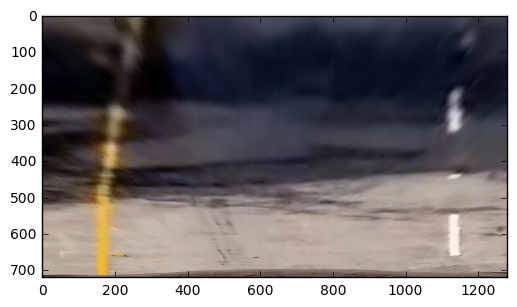

In [246]:
M = cv2.getPerspectiveTransform(src_pts.astype(np.float32), dst_pts.astype(np.float32))
warped_img = cv2.warpPerspective(test_img, M, (W, H), flags=cv2.INTER_LINEAR, )
plt.imshow(warped_img)

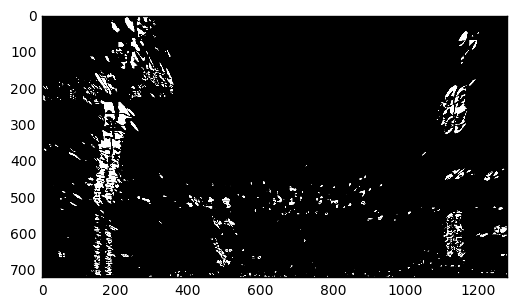

In [247]:
plt.imshow(line_detector(warped_img), cmap = plt.cm.gray)

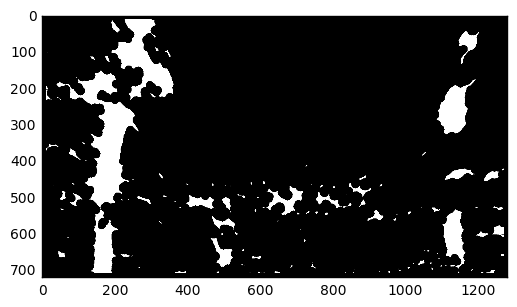

In [248]:
a = line_detector(warped_img)
from skimage.morphology import binary_closing, disk
b = binary_closing(a, selem=disk(11))
plt.imshow(b, cmap=plt.cm.gray)

In [249]:
region.major_axis_length

116.11001381223005

49.955475252277594 72.96694684016148
100.95683511087785 142.38756979440808
7.225151993843567 15.273238187160842
39.28315578233268 76.49869035667788
4.918490759365935 6.28630096645261
29.229158977248975 44.83123827598948
2.5231325220201604 3.0983866769659336
12.565098628628435 27.99857492831986
4.51351666838205 8.646860084094683
12.815923738491737 22.333511876339312
86.06804094011422 150.49222001370063
7.735777827895049 10.22636163077812
29.44615645486938 33.232493285948834
1.9544100476116797 2.3094010767585034
18.01877032173579 29.654142419517367
4.918490759365935 8.462542137142302
1.9544100476116797 3.265986323710904
1.9544100476116797 2.3094010767585034
7.978845608028654 9.426157950305328
3.385137501286538 3.885753375057407
13.013103375051497 20.90288127241256
4.787307364817192 5.6636312470172845
2.256758334191025 2.0
4.918490759365935 8.767651429834977
2.256758334191025 2.8284271247461903
5.4115163798060095 7.93397971290943
4.918490759365935 5.83897243380144
3.9088200952233594 8.090

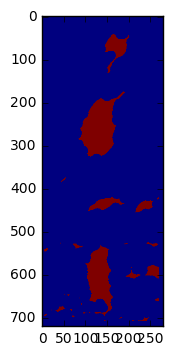

In [250]:
c = b[:,1000:]
plt.imshow(c)
from skimage.measure import label, regionprops
regions = regionprops(label(c))
region = regions[0]
for r in regions:
    print (r.equivalent_diameter, r.major_axis_length)
    
max_len = max([r.major_axis_length for r in regions])

In [251]:
3 / max_len

0.019934585320934756

### Looks interesting? But how is it accurate enough to steer a car?

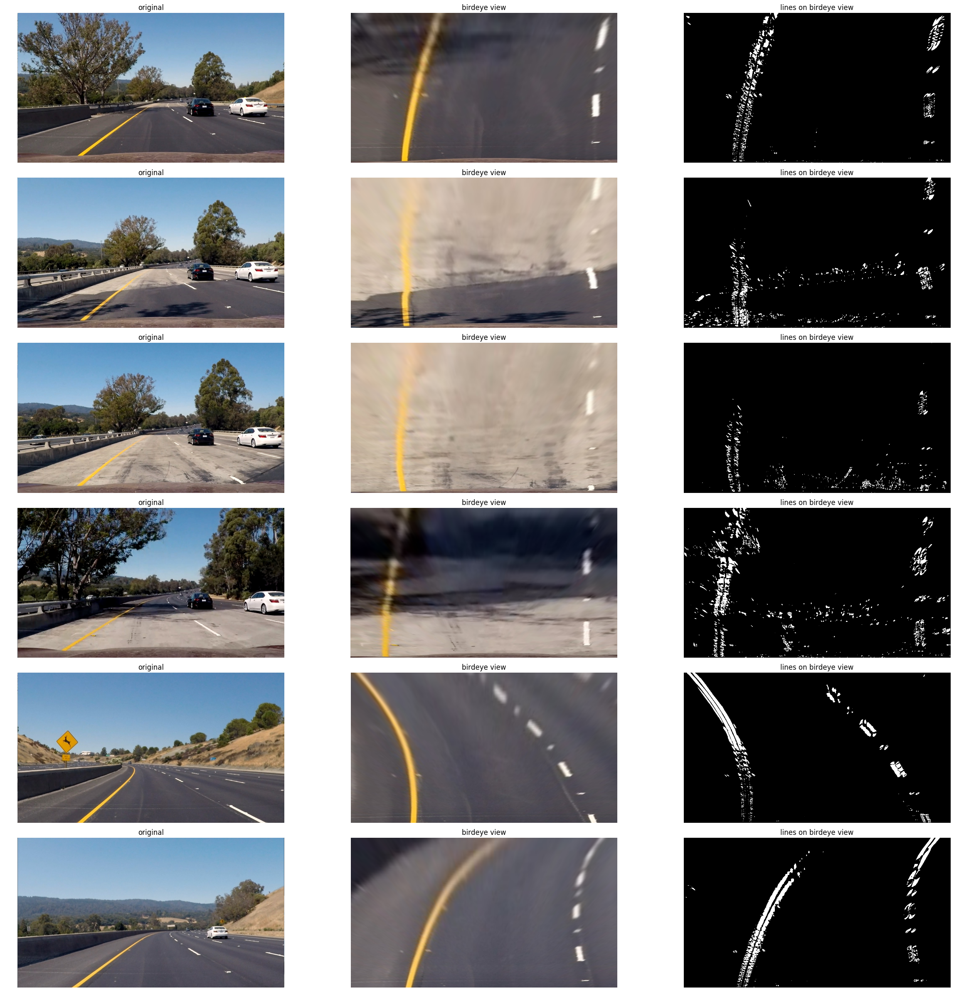

In [134]:
fig, axes = plt.subplots(6, 3, figsize = (8*3, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for ax, img in zip(axes, test_imgs):
    ax[0].imshow(img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    
    warped_img = cv2.warpPerspective(cc.undistort(img), M, (W, H), flags=cv2.INTER_LINEAR, )
    ax[1].imshow(warped_img)
    ax[1].set_title("birdeye view")
    ax[1].set_axis_off()
    
    line_img = line_detector(warped_img)
    ax[2].imshow(line_img, cmap=plt.cm.gray)
    ax[2].set_title("lines on birdeye view")
    ax[2].set_axis_off()


### Wrap the code

In [97]:
def roi_cropper(roi, roi_value=1):
    """Return a function that can be used a step in pipleline
    """

    def crop_roi(bin_img):
        """Crop the roi region of an image, by masking out the other regions.
        - `bin_img`: a binary image, e.g. an image with detected lines.
        - `roi`: region of interest and other areas will be masked out
        - `roi_value`: pixel values to fill the ROI, 1 for binary image, and 255 for gray
        """
        mask = np.zeros_like(bin_img, dtype=np.int32)
        cv2.fillPoly(mask, roi, roi_value)
        masked_img = (bin_img & mask)
        return masked_img
    return crop_roi

In [102]:
class PerspectiveTransformer(object):
    """Perspective Transformation, specially for bird-eye view.
    It fits on a binary image with lines detected, e.g., from result of 
    a LineDetector pipeline, and estimates the transform matrix.
    It transforms new images based on the estimated transform matrix.
    It also estimates/fix-codes the meter-per-pixel on x/y axis.
    """
    def __init__(self, forward_distance=None):
        """Constructor
        `forward_distance`: how far to look forward when estimate the tranform, 
            with the two lane boundaries, it should be roughly a trapzoid.
            if it is None, it will be estimated as half the image height plus a fixed bias.
        `PerspectiveTransformer.M`: transform matrix
        """
        self.M = None
        self.forward_distance = forward_distance
        # meters per pixel on y axis
        self.y_mpp = None
        # meters per pixel on x axis will be estimated later based on the image.
        self.x_mpp = None
    def fit(self, line_img):
        """Estimate the tranform matrix self.M based on a binary image
        with line detected.
        - `line_img`: image with two lines detected, representing the 
        left and right boundaries of lanes. In the transformed
        bird-eye view, the two boundaries should be roughly parallel.
        """
        # image shape
        H, W = test_img.shape[:2]
        # find line coordinates
        ys, xs = np.where(line_img > 0)
        # clustering of two lines
        cluster2 = KMeans(2)
        cluster2.fit(np.c_[xs, ys])
        # build robust linear model for each line
        linear_models = []
        for c in [0, 1]:
            i = (cluster2.labels_ == c)

            robust_model, inliers = ransac(np.c_[xs[i], ys[i]], LineModel, 
                                        min_samples=2, residual_threshold=1., max_trials=500)
            linear_models.append(robust_model)
        # get the vertices of a trapezoid as source points
        if self.forward_distance is None:
            middle_h = H/2 + 100#160
        else:
            middle_h = H - self.forward_distance
        line0 = [(linear_models[0].predict_x(H), H), (linear_models[0].predict_x(middle_h), middle_h)]
        line1 = [(linear_models[1].predict_x(H), H), (linear_models[1].predict_x(middle_h), middle_h)]
        src_pts = np.array(line0 + line1, dtype=np.float32)
        # get the vertices of destination points
        # here simply map it to a rect with same width/length from bottom
        bottom_x1, bottom_x2 = line0[0][0], line1[0][0]
        self.x_mpp = 3 / np.abs(bottom_x1-bottom_x2)
        self.y_mpp = estimate_ympp(??)
        v = np.array(line0[1]) - np.array(line0[0])
        # it must be the same as source trapzoid length otherwise y_mpp will change
        L = H#int(np.sqrt(np.sum( v*v ))) #H
        dst_pts = np.array([(bottom_x1, H), (bottom_x1, H-L),
                           (bottom_x2, H), (bottom_x2, H-L)], 
                          dtype=np.float32)
        # estimate the transform matrix
        self.M =  cv2.getPerspectiveTransform(src_pts, dst_pts)


    def transform(self, img):
        H, W = img.shape[:2]
        warped_img = cv2.warpPerspective(img, self.M, (W, H), flags=cv2.INTER_LINEAR)
        return warped_img

In [121]:
# test Perspective Transformer

test_img = test_imgs[3]
H, W = test_img.shape[:2]



trapezoidal_roi = roi = np.array([[(40,H), (W/2-40, H/2+80), (W/2+40, H/2+80),(W-40,H)]], dtype=np.int32)
undistort_line_crop = make_pipeline([cc.undistort, line_detector, roi_cropper(trapezoidal_roi)])
line_img = undistort_line_crop(test_img)

pt = PerspectiveTransformer(forward_distance=H/2-100)
pt.fit(line_img)

/root/anaconda3/lib/python3.5/site-packages/skimage/measure/fit.py:57: skimage_deprecation: `LineModel` is deprecated, use `LineModelND` instead.
  warn(skimage_deprecation('`LineModel` is deprecated, '


In [122]:
# x_mpp is roughly the same for different images, which is a good sign!
pt.y_mpp, pt.x_mpp

(0.041666666666666664, 0.0030243961978650446)

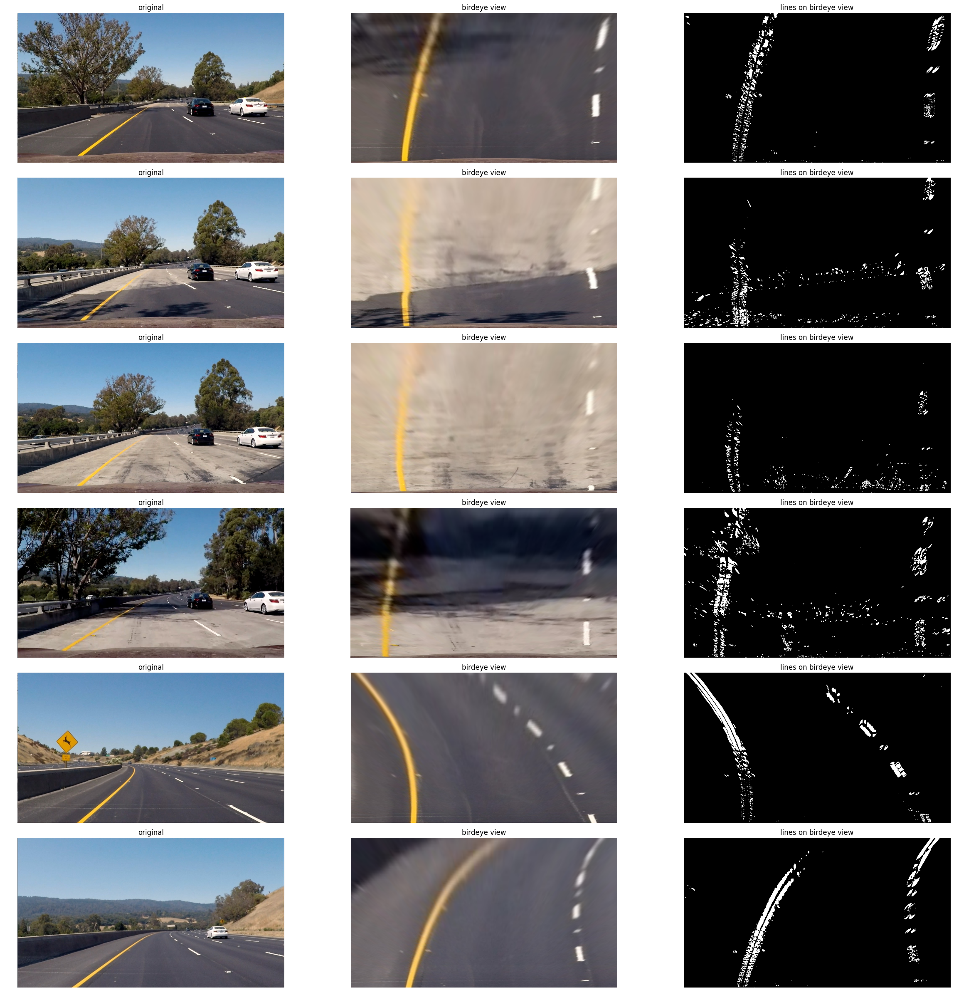

In [123]:
fig, axes = plt.subplots(6, 3, figsize = (8*3, 4*6))
fig.tight_layout()
fig.subplots_adjust(wspace = 0.1, hspace=0.1, )
for ax, img in zip(axes, test_imgs):
    ax[0].imshow(img)
    ax[0].set_title("original")
    ax[0].set_axis_off()
    
    warped_img = pt.transform(cc.undistort(img))
    ax[1].imshow(warped_img)
    ax[1].set_title("birdeye view")
    ax[1].set_axis_off()
    
    line_img = line_detector(warped_img)
    ax[2].imshow(line_img, cmap=plt.cm.gray)
    ax[2].set_title("lines on birdeye view")
    ax[2].set_axis_off()